In [1]:
import os
import numpy as np
import pandas as pd
import seaborn as sns

In [2]:
plt.rcParams['figure.dpi'] = 300
sns.set_context('talk', font_scale= 1.2)

# Figure 4A

In [3]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
umap_path = os.path.join(subsample_path, '20200508_maternal500_fetal_wo_outliers.csv')
adata_df = pd.read_csv(umap_path)

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3049: DtypeWarning: Columns (42) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [4]:
clean_df = adata_df[(adata_df['test_status'] == 'test') & 
                    adata_df['organ'].isin(['PB', 'PL_F', 'PL_M'])]
bl_df = clean_df[(clean_df['challenge'] == 'sal') & (clean_df['timePI'] == '2hr') & (clean_df['origin'] == 'maternal')]

In [5]:
bl_df.columns

Index(['CD45-retroorbital', 'CD45.2', 'CD45.1', 'IdU', 'B220', 'Ly-6G',
       'CD11c', 'TCRb', 'CD115', 'CD69', 'F480', 'CD3', 'IgD', 'CD19', 'CD25',
       'CD64', 'CD80', 'CD8', 'CD11b', 'CD40', 'IgM', 'c-Kit', 'FOXP3',
       'TCRgd', 'CTLA-4', 'Ly-6C', 'CD194', 'CD62L', 'PD-L1', 'FcERI', 'NKp46',
       'Siglec-F', 'CD68', 'CD49b', 'CD44', 'CD4', 'PD-1', 'MHCII', 'CD86',
       'prpS6', 'day', 'organ', 'id', 'cage', 'timePI', 'challenge', 'origin',
       'location', 'leiden1', 'PD-L1_status', 'PD-1_status', 'CTLA-4_status',
       'CD64_status', 'CD62L_status', 'CD25_status', 'CD194_status',
       'CD69_status', 'CD80_status', 'CD86_status', 'B220_status',
       'CD40_status', 'CD44_status', 'IdU_status', 'cell_descript',
       'test_status', 'sample', 'cell_type', 'compartment', 'umap1', 'umap2',
       'cell_type_v2', 'compartment2'],
      dtype='object')

In [6]:
leiden_color_dictv2 = {'B cells': '#FFFF00',
 'CD4+ T cells': '#FF34FF',
 'CD8+ T cells': '#FF4A46',
 'Eosinophils': '#A30059',
 'Basophils': '#b98cdb',
 'Monocytes': '#552de3',
 'NK cells': '#8FB0FF',
 'Neutrophils': '#8393a3',                   
 'DCs': '#1CE6FF'}

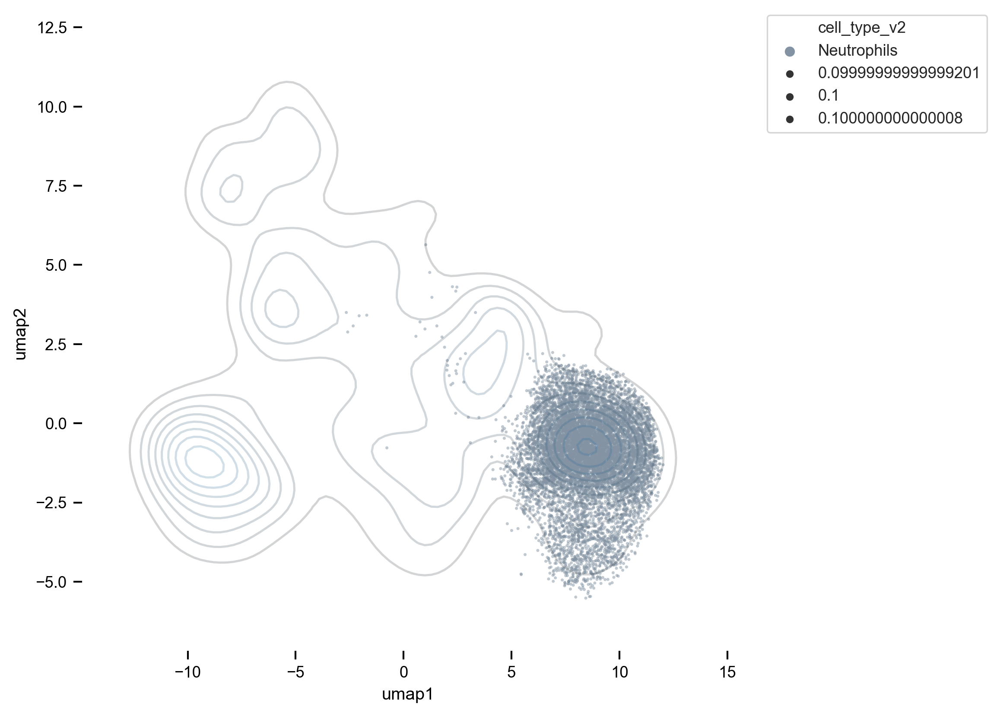

In [7]:
sns.set_context('paper', font_scale= 1)
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.kdeplot(data = bl_df['umap1'], data2= bl_df['umap2'], shade = False, 
            shade_lowest=False, ax = ax, alpha = 0.2, cbar = False)

sns.scatterplot(data = bl_df[bl_df['cell_type_v2']=='Neutrophils'], 
                hue = 'cell_type_v2', palette = leiden_color_dictv2, x='umap1', y='umap2', marker='.', size = 0.1, 
                linewidth = 0, alpha = 0.5, ax = ax)
sns.despine(f, left=True, bottom=True)
sns.set_style("whitegrid", {'axes.grid' : False})
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

# Supplementary Figure 4A

In [15]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
adata_path = os.path.join(subsample_path, 'maternal500_fetal_wo_outliers.h5ad')
adata = sc.read_h5ad(adata_path)

neu_adata_org_bl = adata[adata.obs['cell_type_v2'].isin(['Neutrophils'])&
                            adata.obs['organ'].isin(['PB', 'PL_F', 'PL_M', 'PL_U', 'decidua']) 
                           & (adata.obs['origin'] == 'maternal')
                          & (adata.obs['challenge'] == 'sal')]


subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
neu_adata_path = os.path.join(subsample_path, 'Neu_bl_maternal500wo_outliers.h5ad')
neu_adata_org_bl.write(neu_adata_path)

In [19]:
neu_adata_org_bl.var_names

Index(['CD45-retroorbital', 'CD45.2', 'CD45.1', 'IdU', 'B220', 'Ly-6G',
       'CD11c', 'TCRb', 'CD115', 'CD69', 'F480', 'CD3', 'IgD', 'CD19', 'CD25',
       'CD64', 'CD80', 'CD8', 'CD11b', 'CD40', 'IgM', 'c-Kit', 'FOXP3',
       'TCRgd', 'CTLA-4', 'Ly-6C', 'CD194', 'CD62L', 'PD-L1', 'FcERI', 'NKp46',
       'Siglec-F', 'CD68', 'CD49b', 'CD44', 'CD4', 'PD-1', 'MHCII', 'CD86',
       'prpS6'],
      dtype='object', name='index')

In [25]:
sc.tl.pca(neu_adata_org_bl, n_comps = 3, random_state = 1)

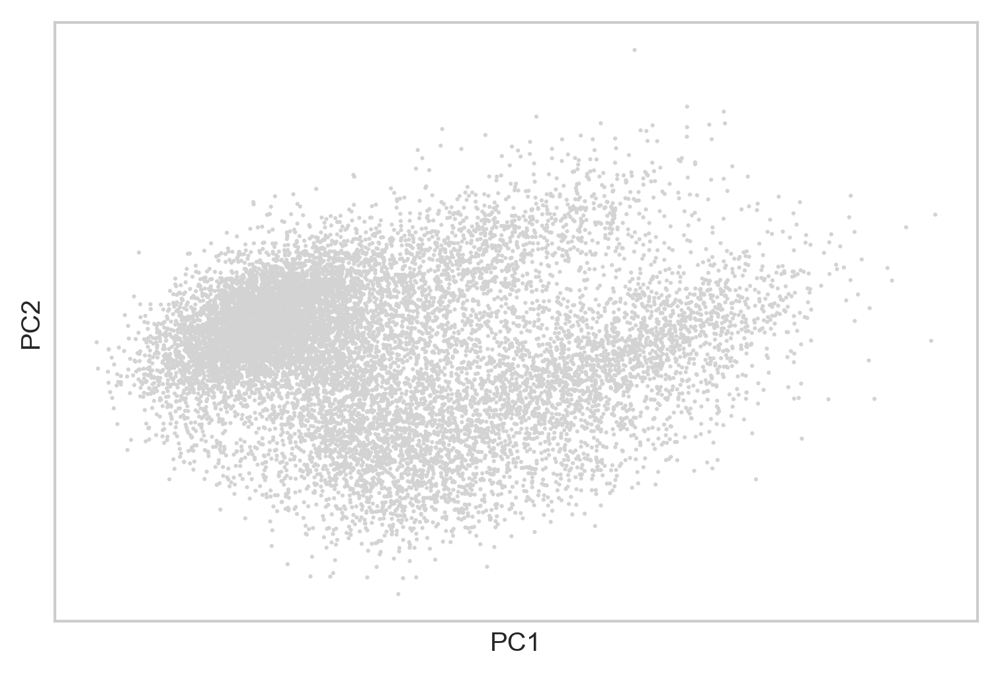

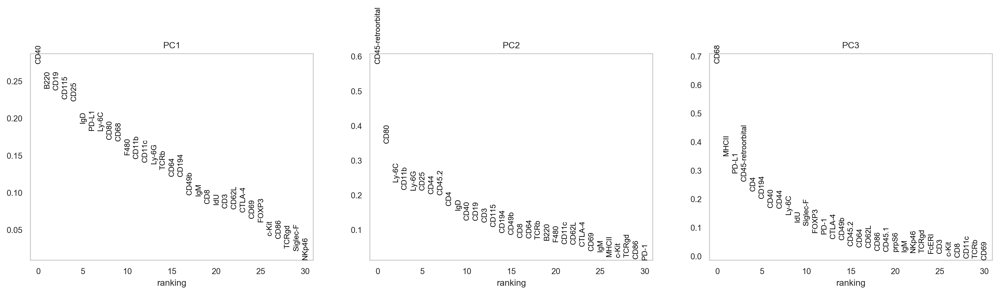

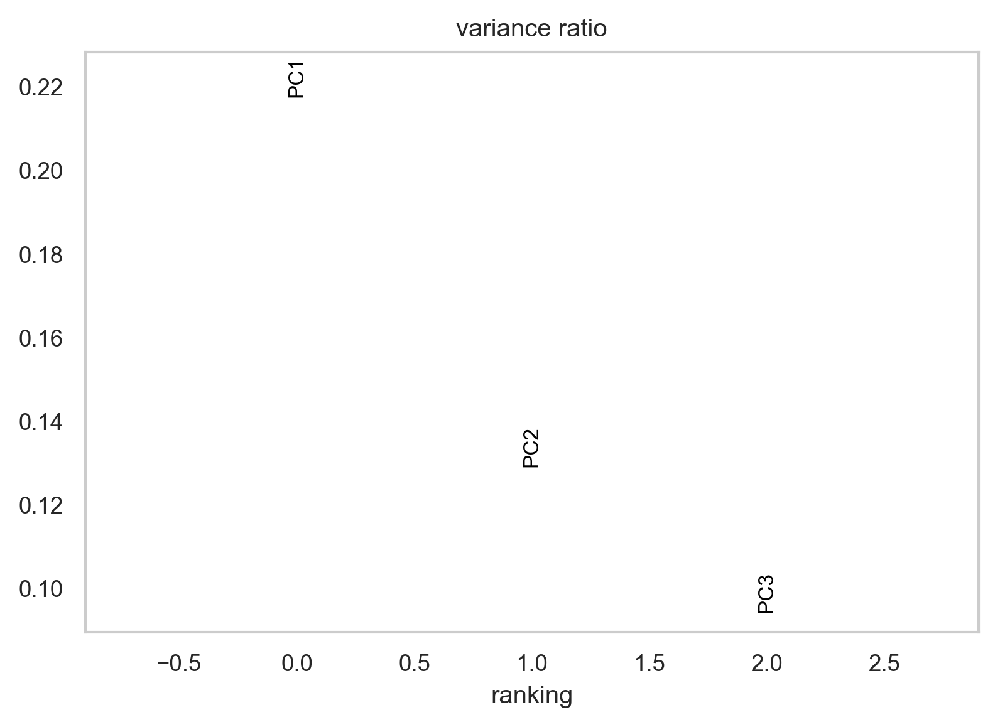

In [26]:
sc.pl.pca_overview(neu_adata_org_bl)

# Supplementary figure 4

# cluster with PDL1 and canonical neutrophil markers + IdU

In [3]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
neu_adata_path = os.path.join(subsample_path, 'Neu_bl_maternal500wo_outliers.h5ad')
neu_adata_org_bl = sc.read_h5ad(neu_adata_path)

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/anndata/core/anndata.py:846: FutureWarning: In anndata v0.7+, arrays contained within an AnnData object will maintain their dimensionality. For example, prior to v0.7 `adata[0, 0].X` returned a scalar and `adata[0, :]` returned a 1d array, post v0.7 they will return two dimensional arrays. If you would like to get a one dimensional array from your AnnData object, consider using the `adata.obs_vector`, `adata.var_vector` methods or accessing the array directly.
  warn_flatten()


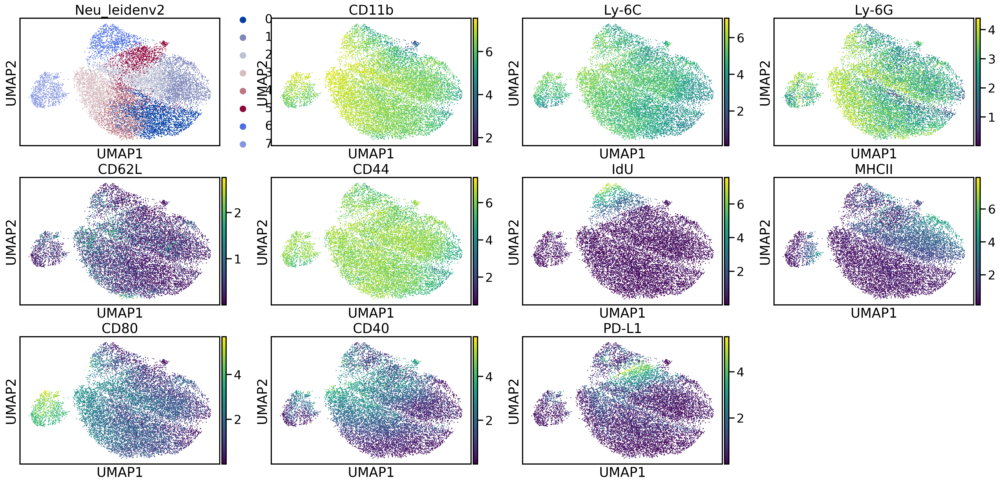

In [4]:
clustering =  ['CD11b','Ly-6C', 'Ly-6G', 'CD62L', 'CD44', 'IdU', 'MHCII', 'CD80', 'CD40', 'PD-L1']
neu_adata_org_bl.obsm['cluster_channels'] = neu_adata_org_bl[:, clustering].X
sc.pp.neighbors(neu_adata_org_bl, n_neighbors = 20, use_rep= 'cluster_channels', random_state = 1)
sc.tl.umap(neu_adata_org_bl, random_state = 1)
sc.tl.leiden(neu_adata_org_bl, resolution=0.5, key_added = 'Neu_leidenv2', random_state = 1)
sc.pl.umap(neu_adata_org_bl, color = ['Neu_leidenv2', 'CD11b','Ly-6C', 'Ly-6G', 'CD62L', 'CD44', 'IdU', 'MHCII', 'CD80', 'CD40', 'PD-L1'], use_raw = False)

In [5]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
neu_adata_path = os.path.join(subsample_path, 'Neu_bl_maternal500wo_outliers.h5ad')
neu_adata_org_bl.write(neu_adata_path)

In [6]:
umap_pd = pd.DataFrame(data = neu_adata_org_bl.obsm['X_umap'], columns = ['umap1', 'umap2']).set_index(neu_adata_org_bl.obs_names)
adata_df = pd.DataFrame(data = neu_adata_org_bl.X, columns = neu_adata_org_bl.var_names).set_index(neu_adata_org_bl.obs_names)
adata_df = pd.concat([adata_df, neu_adata_org_bl.obs, umap_pd], axis = 1, join = 'outer', copy = False)

In [7]:
adata_df.head(5)

,CD45-retroorbital,CD45.2,CD45.1,IdU,B220,Ly-6G,CD11c,TCRb,CD115,CD69,...,sample,cell_type,compartment,leiden0,gen_cell_type,cell_type_v2,compartment2,Neu_leidenv2,umap1,umap2
index,,,,,,,,,,,,,,,,,,,,,
16,3.733698,3.482318,0.025405,0.000362,3.540359,2.862674,1.361506,1.185081,0.864763,0.312589,...,E12.5_3576_15,Neutrophils Ly6Ghi,PB-EV,2,Neu,Neutrophils,PB-EV,1,3.744891,2.421521
46,5.030386,3.235032,0.000000,0.156082,3.322356,1.621257,2.450964,0.995553,0.636060,0.502439,...,E12.5_3576_15,Neutrophils Ly6Ghi,PB-EV,10,B_cells,Neutrophils,PB-EV,1,2.942671,3.768196
190,3.762684,4.037537,0.113570,0.000362,3.977293,2.253136,2.469895,2.150812,0.965666,0.292154,...,E12.5_3576_15,Neutrophils Ly6Ghi,PB-EV,2,Neu,Neutrophils,PB-EV,7,-5.935161,-0.735127
240,2.139523,3.691419,0.052421,0.000362,1.301516,0.089487,0.008133,0.087274,0.224940,0.002609,...,E12.5_3576_15,Neutrophils Ly6Gmid,PB-EV,8,Neu,Neutrophils,PB-EV,2,0.529018,1.207883
68-1,3.356221,1.707314,0.100837,0.000362,3.977293,1.615526,2.796888,0.087274,0.951465,0.269706,...,E12.5_3574_1,Neutrophils Ly6Ghi,PB-EV,2,Neu,Neutrophils,PB-EV,1,3.583579,3.759507


In [8]:
adata_df.rename(columns = {'Neu_leidenv2': 'Neu_leiden2'}, inplace = True)

In [9]:
adata_df.head(5)

,CD45-retroorbital,CD45.2,CD45.1,IdU,B220,Ly-6G,CD11c,TCRb,CD115,CD69,...,sample,cell_type,compartment,leiden0,gen_cell_type,cell_type_v2,compartment2,Neu_leiden2,umap1,umap2
index,,,,,,,,,,,,,,,,,,,,,
16,3.733698,3.482318,0.025405,0.000362,3.540359,2.862674,1.361506,1.185081,0.864763,0.312589,...,E12.5_3576_15,Neutrophils Ly6Ghi,PB-EV,2,Neu,Neutrophils,PB-EV,1,3.744891,2.421521
46,5.030386,3.235032,0.000000,0.156082,3.322356,1.621257,2.450964,0.995553,0.636060,0.502439,...,E12.5_3576_15,Neutrophils Ly6Ghi,PB-EV,10,B_cells,Neutrophils,PB-EV,1,2.942671,3.768196
190,3.762684,4.037537,0.113570,0.000362,3.977293,2.253136,2.469895,2.150812,0.965666,0.292154,...,E12.5_3576_15,Neutrophils Ly6Ghi,PB-EV,2,Neu,Neutrophils,PB-EV,7,-5.935161,-0.735127
240,2.139523,3.691419,0.052421,0.000362,1.301516,0.089487,0.008133,0.087274,0.224940,0.002609,...,E12.5_3576_15,Neutrophils Ly6Gmid,PB-EV,8,Neu,Neutrophils,PB-EV,2,0.529018,1.207883
68-1,3.356221,1.707314,0.100837,0.000362,3.977293,1.615526,2.796888,0.087274,0.951465,0.269706,...,E12.5_3574_1,Neutrophils Ly6Ghi,PB-EV,2,Neu,Neutrophils,PB-EV,1,3.583579,3.759507


In [10]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
umap_path = os.path.join(subsample_path, '20201015_Neu_bl_maternal500wo_outliers.csv')
adata_df.to_csv(umap_path, index = False)

In [11]:
neu_clean_df = adata_df[(adata_df['test_status'] == 'test') & adata_df['organ'].isin(['PB', 'PL_F', 'PL_M'])]

In [12]:
neu_clean_df['Neu_leiden2'].unique()

[1, 7, 2, 5, 3, 4, 6, 0]
Categories (8, object): [1, 7, 2, 5, 3, 4, 6, 0]

In [13]:
neu_clean_df['Neu_leiden2'] = neu_clean_df['Neu_leiden2'].astype('str')

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [14]:
Neu_leiden2_dict = {'0': '#d67c0d',
'1': '#32a852',
'2': '#876507',
'3': '#d6bcc0',
'4': '#023fa5',
'5': '#d60d0d',
'6': '#d60dcf',
'7': '#0dd6d3'}

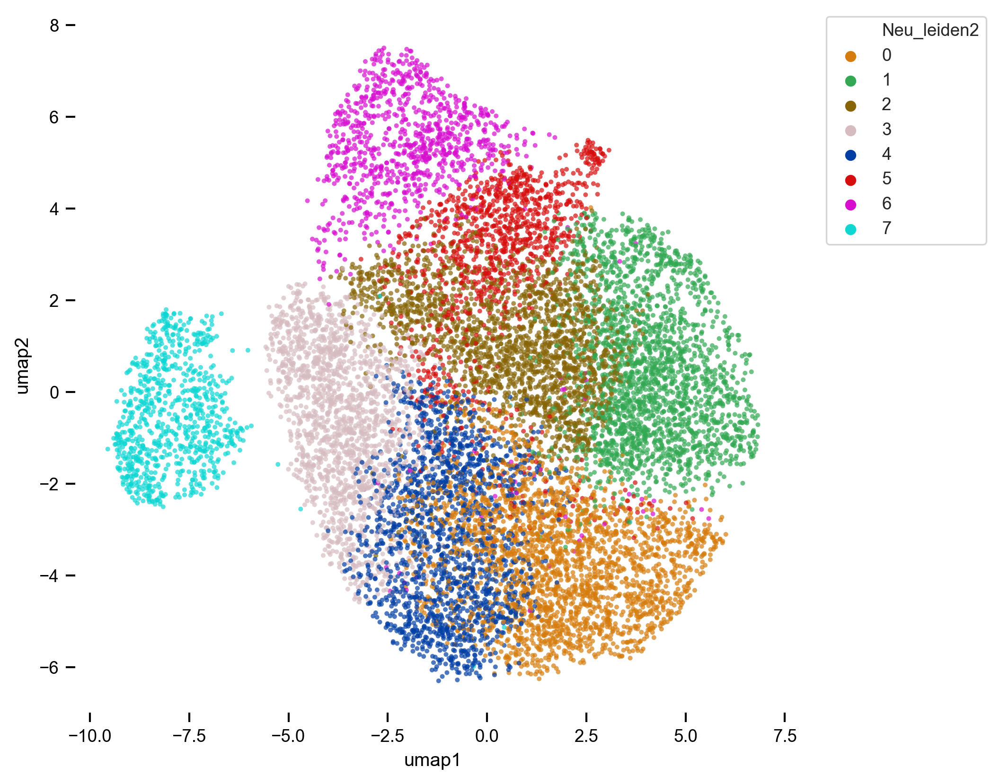

In [15]:
sns.set_context('paper', font_scale= 1)
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.scatterplot(x='umap1', y='umap2', 
                data = neu_clean_df, 
                hue = 'Neu_leiden2', hue_order = ['0', '1', '2', '3', '4', '5','6', '7'],
                palette = Neu_leiden2_dict, 
                marker='.', linewidth = 0, alpha = 0.7)
sns.set_style("whitegrid", {'axes.grid' : False})
sns.despine(f, left=True, bottom=True)
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

In [16]:
clustering = ['CD11b','Ly-6C', 'Ly-6G', 'CD62L', 'CD44', 'IdU', 'MHCII', 'CD80', 'CD40', 'PD-L1']

In [17]:
neu_clean_df.columns

Index(['CD45-retroorbital', 'CD45.2', 'CD45.1', 'IdU', 'B220', 'Ly-6G',
       'CD11c', 'TCRb', 'CD115', 'CD69', 'F480', 'CD3', 'IgD', 'CD19', 'CD25',
       'CD64', 'CD80', 'CD8', 'CD11b', 'CD40', 'IgM', 'c-Kit', 'FOXP3',
       'TCRgd', 'CTLA-4', 'Ly-6C', 'CD194', 'CD62L', 'PD-L1', 'FcERI', 'NKp46',
       'Siglec-F', 'CD68', 'CD49b', 'CD44', 'CD4', 'PD-1', 'MHCII', 'CD86',
       'prpS6', 'day', 'organ', 'id', 'cage', 'timePI', 'challenge', 'origin',
       'location', 'leiden1', 'PD-L1_status', 'PD-1_status', 'CTLA-4_status',
       'CD64_status', 'CD62L_status', 'CD25_status', 'CD194_status',
       'CD69_status', 'CD80_status', 'CD86_status', 'B220_status',
       'CD40_status', 'CD44_status', 'IdU_status', 'cell_descript',
       'test_status', 'sample', 'cell_type', 'compartment', 'leiden0',
       'gen_cell_type', 'cell_type_v2', 'compartment2', 'Neu_leiden2', 'umap1',
       'umap2'],
      dtype='object')

In [18]:
neu_clean_df[clustering] = neu_clean_df[clustering].apply(lambda x:(x-x.min()) / (x.max()-x.min()))
neu_melt= neu_clean_df.melt(id_vars=['compartment2','Neu_leiden2', 'cage','id', 'day', 'umap1', 'umap2'], value_vars = clustering)
neu_melt.rename(columns = {'variable': 'marker', 'value': 'median'}, inplace = True)

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/pandas/core/frame.py:3391: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self[k1] = value[k2]


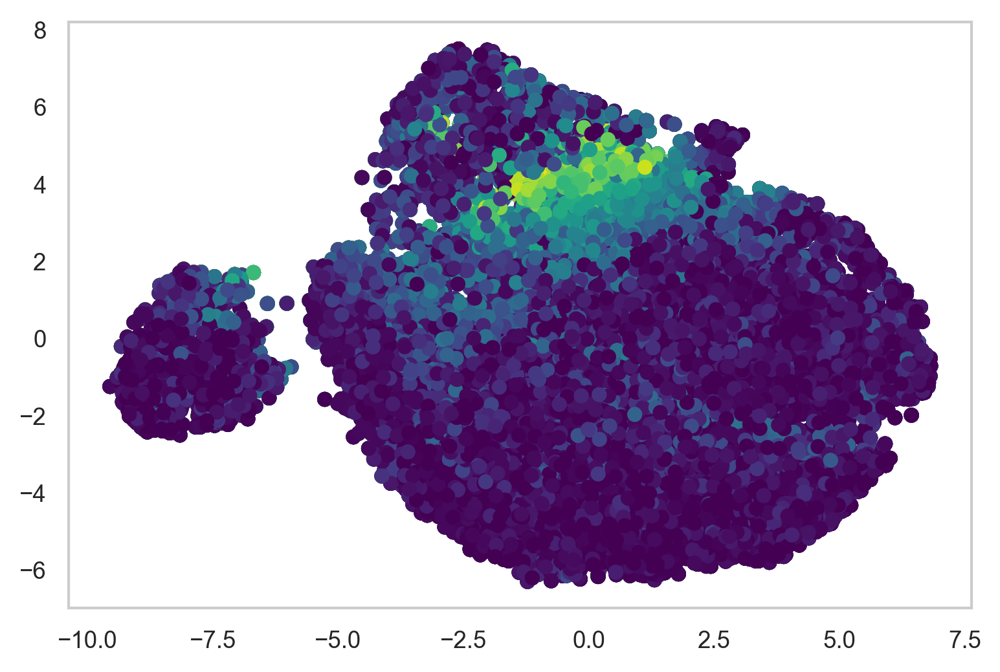

In [19]:
points = plt.scatter(neu_melt['umap1'], neu_melt['umap2'], c = neu_melt['median'], cmap='viridis')

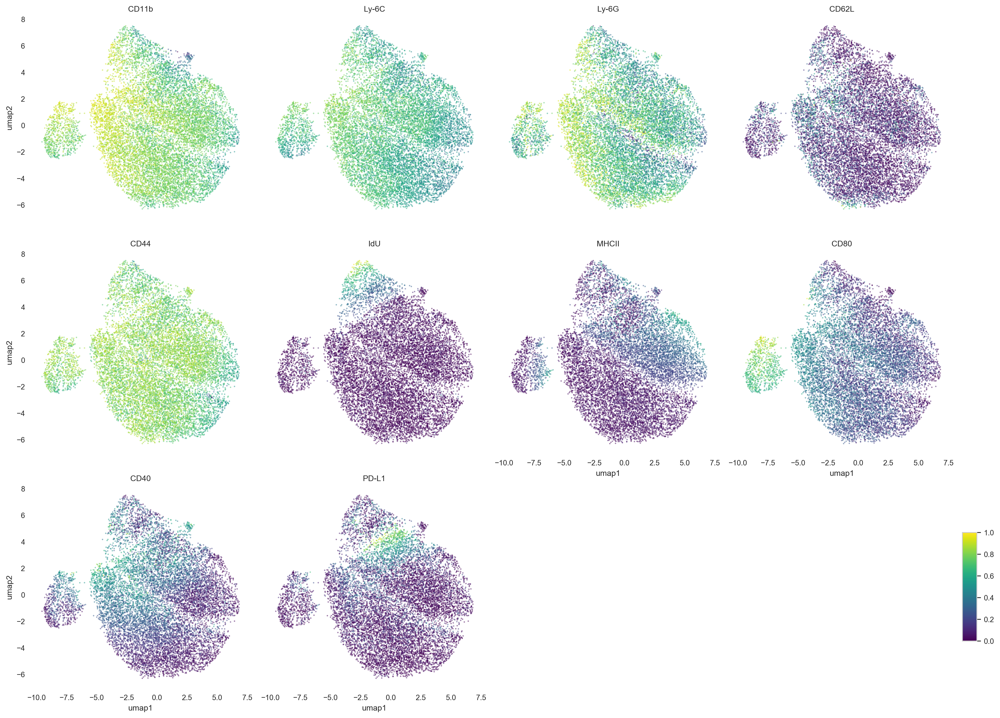

In [20]:
sns.set_context('paper', font_scale= 1)
g = sns.relplot(x='umap1', y= 'umap2', hue = 'median', col= 'marker', data= neu_melt,
                height=4, aspect=1, kind="scatter", palette = 'viridis', col_wrap=4,
                marker='.', size = 0.1, linewidth = 0, alpha = 0.5, legend = False).set_titles('{col_name}')
cax = g.fig.add_axes([1, .11, 0.015, 0.15])
plt.colorbar(points, cax=cax)
sns.despine(g, left=True, bottom=True)

# Figure 4A

In [21]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
umap_path = os.path.join(subsample_path, '20201015_Neu_bl_maternal500wo_outliers.csv')
neu_df = pd.read_csv(umap_path)

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3049: DtypeWarning: Columns (42) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [22]:
columns_int = ['CD45-retroorbital', 'CD45.2', 'CD45.1', 'IdU', 'B220', 'Ly-6G',
       'CD11c', 'TCRb', 'CD115', 'CD69', 'F480', 'CD3', 'IgD', 'CD19', 'CD25',
       'CD64', 'CD80', 'CD8', 'CD11b', 'CD40', 'IgM', 'c-Kit', 'FOXP3',
       'TCRgd', 'CTLA-4', 'Ly-6C', 'CD62L', 'PD-L1', 'FcERI', 'NKp46',
       'Siglec-F', 'CD68', 'CD49b', 'CD44', 'CD4', 'PD-1', 'MHCII', 'CD86', 
               'cage','challenge', 'day', 'id', 'Neu_leiden2', 'compartment2']

In [23]:
neu_clean_df = neu_df[(neu_df['test_status'] == 'test') & neu_df['organ'].isin(['PB', 'PL_F', 'PL_M'])]
pivot_series = neu_clean_df[columns_int].pivot_table(columns= ['Neu_leiden2', 'compartment2','challenge', 'cage','id', 'day'], aggfunc = 'median')

In [24]:
median_df = pd.DataFrame(pivot_series)
median_df.reset_index(inplace = True)
median_df.rename(columns = {'level_0': 'marker', 0: 'median'}, inplace = True)
mean_medians = median_df.groupby(['marker','Neu_leiden2']).mean()
mean_medians.reset_index(inplace = True)
heatmap_df = mean_medians.pivot_table(index = 'marker', columns = 'Neu_leiden2', values = 'median')

In [25]:
heatmap_ready = heatmap_df.apply(lambda x:(x-x.min()) / (x.max()-x.min()), axis = 1)

In [26]:
heatmap_ready

Neu_leiden2,0,1,2,3,4,5,6,7
marker,,,,,,,,
B220,0.000000,0.399176,0.910570,1.000000,0.208135,0.605811,0.746301,0.593082
CD115,0.000000,0.046080,0.604797,1.000000,0.124017,0.303019,0.416154,0.411349
CD11b,0.257576,0.084009,0.655295,1.000000,0.464419,0.000000,0.247493,0.511518
CD11c,0.000000,0.278354,0.675818,1.000000,0.301140,0.959308,0.590144,0.614583
CD19,0.000000,0.108248,0.696016,1.000000,0.291573,0.188688,0.337633,0.534031
CD25,0.074762,0.000000,0.633507,1.000000,0.272141,0.121511,0.420450,0.630393
CD3,0.000000,0.153355,0.711543,1.000000,0.222982,0.457310,0.337374,0.452640
CD4,0.000000,0.215782,1.000000,0.611076,0.834463,0.608311,0.357387,0.484610
CD40,0.000000,0.054489,0.691416,1.000000,0.307551,0.883743,0.554151,0.299290


In [27]:
heatmap_ready.columns = heatmap_ready.columns.astype('str')

In [28]:
heat_t = heatmap_ready.loc[:, ['3','1', '6', '7', '0', '2', '5', '4']]

In [29]:
int_markers =  ['CD11b','Ly-6C', 'Ly-6G', 'CD62L', 'CD44', 'IdU', 'MHCII', 'CD80', 'CD40', 'PD-L1']

In [30]:
Neu_leiden2_dict = {'0': '#d67c0d',
'1': '#32a852',
'2': '#876507',
'3': '#d6bcc0',
'4': '#023fa5',
'5': '#d60d0d',
'6': '#d60dcf',
'7': '#0dd6d3'}

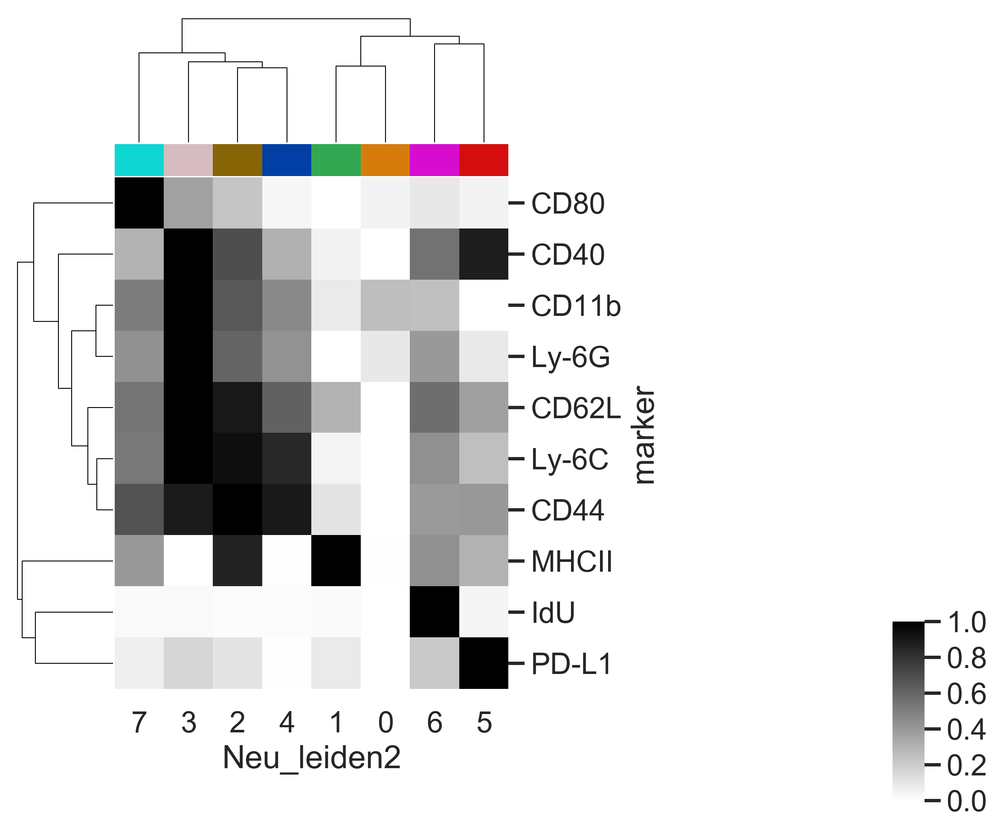

In [31]:
sns.set_context('talk', font_scale= 1)
col_colors = heat_t.columns.map(Neu_leiden2_dict)
cg = sns.clustermap(heat_t.loc[int_markers], figsize=(5,7),
               cmap = 'binary', col_colors = col_colors,
               row_cluster = True, col_cluster = True)
plt.setp(cg.ax_heatmap.yaxis.get_majorticklabels(), rotation=0)
cg.cax.set_position((1.5,0.0,.05,.2))

In [32]:
cell_counts = pd.DataFrame(data = neu_clean_df.groupby(['Neu_leiden2', 'compartment2', 'organ', 'location','day', 'challenge','timePI','cage', 'id', 'test_status']).apply(len))
cell_counts.reset_index(inplace = True)
cell_counts.rename(columns = {0: 'counts'}, inplace = True)
cell_counts['sample'] = cell_counts['cage'].astype(str).str.cat(cell_counts['id'].astype(str), sep= '_')
cell_counts['sample'] = cell_counts['sample'].str.cat(cell_counts['day'], sep= '_')
cell_counts['sample'] = cell_counts['sample'].str.cat(cell_counts['challenge'], sep= '_')
cell_counts['sample'] = cell_counts['sample'].str.cat(cell_counts['timePI'], sep= '_')
cell_counts['sample'] = cell_counts['sample'].str.cat(cell_counts['organ'], sep= '_')
cell_counts['sample'] = cell_counts['sample'].str.cat(cell_counts['location'], sep= '_')
sample_total = pd.DataFrame(data = cell_counts.groupby(['sample']).sum())
sample_dict = sample_total.to_dict()
cell_counts.loc[:,'sample_total'] = cell_counts['sample'].map(sample_dict['counts'])
cell_counts['frac_of_comp_sample'] = cell_counts['counts']/cell_counts['sample_total']
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
counts_csv = '20201015_maternalNeu_edited_counts_per_sample.csv'
counts_filepath = os.path.join(subsample_path, counts_csv)
cell_counts.to_csv(counts_filepath, index = False)                                                 

In [33]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
counts_csv = '20201015_maternalNeu_edited_counts_per_sample.csv'
counts_filepath = os.path.join(subsample_path, counts_csv)
cell_counts= pd.read_csv(counts_filepath)                                                 

In [34]:
cell_counts['Neu_leiden2'] = cell_counts['Neu_leiden2'].astype('str')

In [35]:
clean_cell_counts = cell_counts[cell_counts['test_status'] == 'test']
clean_cell_counts['cage'] = clean_cell_counts['cage'].astype('category')
composite = clean_cell_counts.groupby(['Neu_leiden2', 'day','compartment2']).agg(['mean', 'sem'])
mean_sem_comp = composite.reorder_levels([1, 0], axis = 1)

In [36]:
composite_frac_all = pd.DataFrame(data = mean_sem_comp['mean']['frac_of_comp_sample'])
composite_frac_all.reset_index(inplace = True)
heatmap_all = composite_frac_all.pivot_table(index = ['Neu_leiden2'], columns = 'compartment2', values = 'frac_of_comp_sample')
heatmap_all= heatmap_all.fillna(0)

In [37]:
heatmap_all=heatmap_all.loc[:,['PL-T', 'PL-EV', 'PB-EV']]

In [38]:
heat_counts = heatmap_all.loc[['7','3', '2', '4', '1', '0','6', '5'], :]

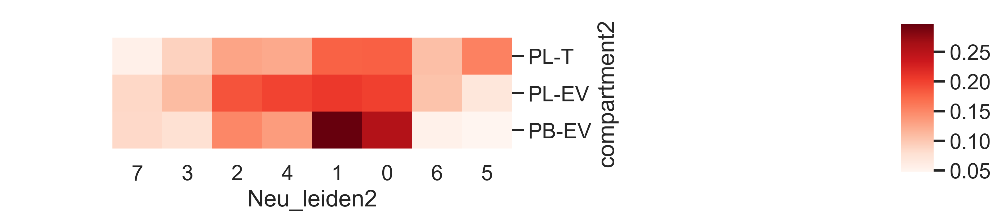

In [39]:
cg = sns.clustermap(heat_counts.transpose(), figsize=(7, 2),
               cmap = 'Reds',  
               row_cluster = False, col_cluster = False)
plt.setp(cg.ax_heatmap.yaxis.get_majorticklabels(), rotation=0)
cg.cax.set_position((1.5,0.0,.05,.8))

# Figure 4B

In [40]:
median_df.head(5)

,marker,Neu_leiden2,compartment2,challenge,cage,id,day,median
0,CD45-retroorbital,0,PB-EV,sal,428,13,E18.5,4.301116
1,CD45-retroorbital,0,PB-EV,sal,428,14,E12.5,4.287190
2,CD45-retroorbital,0,PB-EV,sal,429,16,E18.5,4.305671
3,CD45-retroorbital,0,PB-EV,sal,429,19,E11.5,3.804069
4,CD45-retroorbital,0,PB-EV,sal,429,20,E18.5,4.119625


In [41]:
median_df['Neu_leiden2'] = median_df['Neu_leiden2'].astype('str')

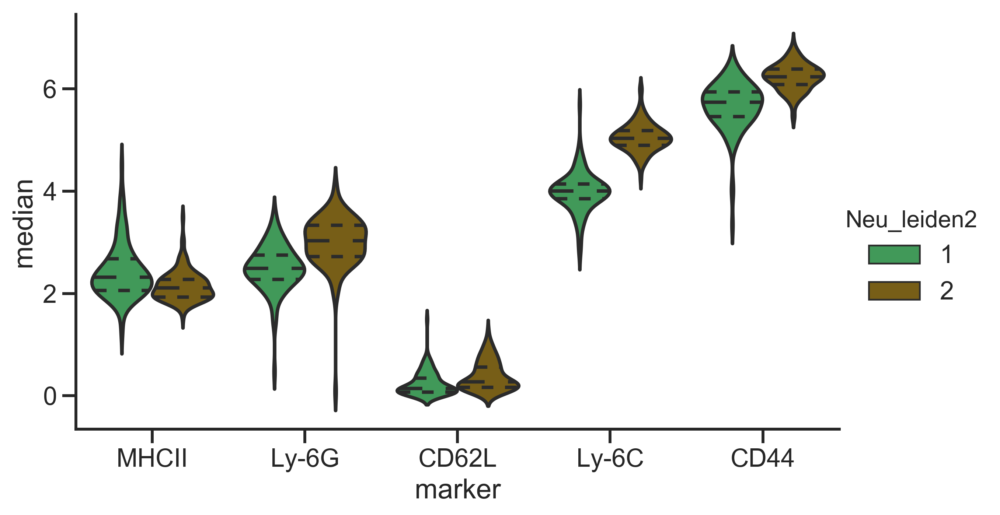

In [42]:
sns.set_style("ticks")
sns.catplot(x = 'marker', y = 'median', kind = 'violin',inner = 'quart',
            hue = 'Neu_leiden2', palette = Neu_leiden2_dict, order = ['MHCII','Ly-6G','CD62L', 'Ly-6C', 'CD44'],
            scale='count', ci = 68, data = median_df[median_df['marker'].isin(['MHCII','Ly-6G','CD62L', 'Ly-6C', 'CD44']) & median_df['Neu_leiden2'].isin(['2','1'])],
            legend_out = True, aspect = 1.6, height = 5)

In [64]:
from scipy.stats import ttest_ind

In [66]:
t_test_data = pd.DataFrame(columns =['cluster1', 'cluster2', 'marker','t-stat', 'p-value', 'Stat diff'])

In [67]:
leiden_combos = [('0', '5'), ('0', '7'), ('5', '7')]

In [68]:
for leiden_comb in leiden_combos:
    for marker in ['PD-L1', 'Ly-6C','MHCII', 'CD64']:
    
            marker_leiden1 = median_df[(median_df['marker']== marker) & 
                                    (median_df['Mo_leiden2']== leiden_comb[0])]
            marker_leiden2 = median_df[(median_df['marker']== marker) & 
                                    (median_df['Mo_leiden2']== leiden_comb[1])]

            t_stat, p = ttest_ind(marker_leiden1['median'], marker_leiden2['median'])
            alpha = 0.05
            if p > alpha:
                dist = 'no'
            else:
                dist = 'yes'
            data_df = pd.DataFrame(data ={'cluster1': [leiden_comb[0]],
                                          'cluster2': [leiden_comb[1]],
                                          'marker': [marker], 
                                          't-stat': [t_stat], 
                                          'p-value': [p], 
                                          'Stat diff':[ dist]})
            t_test_data = t_test_data.append(data_df)

In [69]:
t_test_data

,cluster1,cluster2,marker,t-stat,p-value,Stat diff
0,0,5,PD-L1,-4.448296,1.343290e-05,yes
0,0,5,Ly-6C,23.884598,1.882287e-64,yes
0,0,5,MHCII,42.873642,3.052953e-112,yes
0,0,5,CD64,21.246851,2.398973e-56,yes
0,0,7,PD-L1,-7.764782,4.763171e-13,yes
0,0,7,Ly-6C,15.803163,1.389232e-36,yes
0,0,7,MHCII,32.853985,9.576712e-81,yes
0,0,7,CD64,-14.399058,2.337539e-32,yes
0,5,7,PD-L1,-5.547858,9.094408e-08,yes
0,5,7,Ly-6C,-4.461513,1.356929e-05,yes


# Figure 3D supplementary

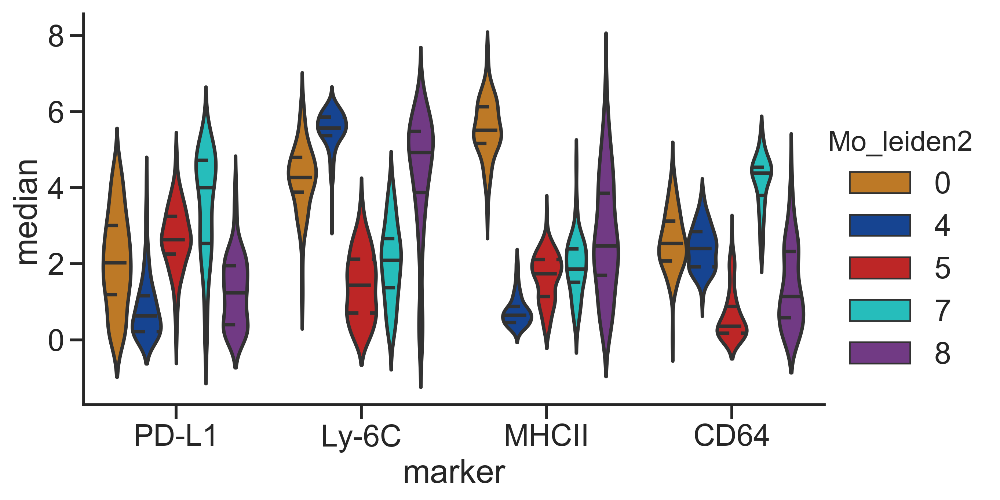

In [11]:
sns.set_style("ticks")
sns.catplot(x = 'marker', y = 'median', kind = 'violin',inner = 'quart',
            hue = 'Mo_leiden2', palette = Mo_leiden2_dict, order = ['PD-L1', 'Ly-6C','MHCII', 'CD64'],
            scale='count', ci = 68, data = median_df[median_df['marker'].isin(['PD-L1', 'Ly-6C','MHCII', 'CD64']) & median_df['Mo_leiden2'].isin(['0', '4','5', '7', '8'])],
            legend_out = True, aspect = 1.6, height = 5)

In [12]:
from scipy.stats import ttest_ind
t_test_data = pd.DataFrame(columns =['cluster1', 'cluster2', 'marker','t-stat', 'p-value', 'Stat diff'])
leiden_combos = [('0', '4'), ('0', '5'), ('0', '7'), ('0', '8'), ('4', '5'), ('4', '7'), ('4', '8'), ('5', '7'), ('5', '8'), ('7', '8')]
for leiden_comb in leiden_combos:
    for marker in ['PD-L1', 'Ly-6C','MHCII', 'CD64']:
    
            marker_leiden1 = median_df[(median_df['marker']== marker) & 
                                    (median_df['Mo_leiden2']== leiden_comb[0])]
            marker_leiden2 = median_df[(median_df['marker']== marker) & 
                                    (median_df['Mo_leiden2']== leiden_comb[1])]

            t_stat, p = ttest_ind(marker_leiden1['median'], marker_leiden2['median'])
            alpha = 0.05
            if p > alpha:
                dist = 'no'
            else:
                dist = 'yes'
            data_df = pd.DataFrame(data ={'cluster1': [leiden_comb[0]],
                                          'cluster2': [leiden_comb[1]],
                                          'marker': [marker], 
                                          't-stat': [t_stat], 
                                          'p-value': [p], 
                                          'Stat diff':[ dist]})
            t_test_data = t_test_data.append(data_df)

In [13]:
t_test_data

,cluster1,cluster2,marker,t-stat,p-value,Stat diff
0,0,4,PD-L1,8.797054,3.520558e-16,yes
0,0,4,Ly-6C,-13.090119,1.425131e-29,yes
0,0,4,MHCII,60.797365,7.092695e-143,yes
0,0,4,CD64,2.161952,3.166297e-02,yes
0,0,5,PD-L1,-4.448296,1.343290e-05,yes
0,0,5,Ly-6C,23.884598,1.882287e-64,yes
0,0,5,MHCII,42.873642,3.052953e-112,yes
0,0,5,CD64,21.246851,2.398973e-56,yes
0,0,7,PD-L1,-7.764782,4.763171e-13,yes
0,0,7,Ly-6C,15.803163,1.389232e-36,yes


# Figure 4C

In [43]:
neu_clean_df['Neu_leiden2'] = neu_clean_df['Neu_leiden2'] .astype('str')

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [44]:
PB = neu_clean_df[neu_clean_df['compartment2'] == 'PB-EV']
EV = neu_clean_df[neu_clean_df['compartment2'] == 'PL-EV']
TIS = neu_clean_df[neu_clean_df['compartment2']=='PL-T']

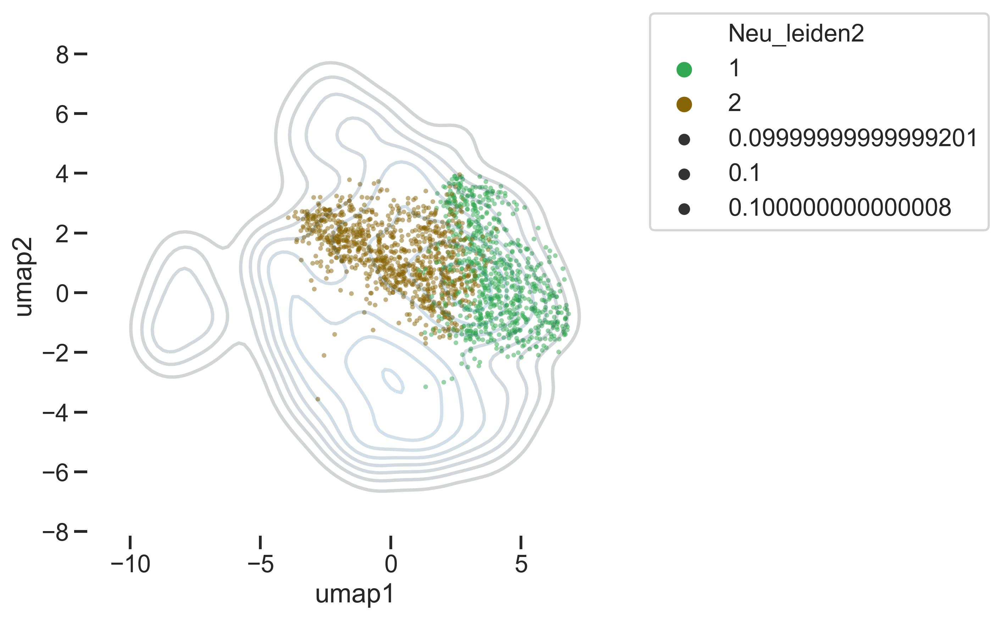

In [45]:
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.kdeplot(data = neu_clean_df['umap1'], data2= neu_clean_df['umap2'], shade = False, 
            shade_lowest=False, ax = ax, alpha = 0.2, cbar = False)
sns.scatterplot(data = TIS[TIS['Neu_leiden2'].isin(['1', '2'])], hue = 'Neu_leiden2', palette = Neu_leiden2_dict, x='umap1', y='umap2', marker='.', size = 0.1, linewidth = 0, alpha = 0.5, ax = ax)
sns.despine(f, left=True, bottom=True)
sns.set_style("whitegrid", {'axes.grid' : False})
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

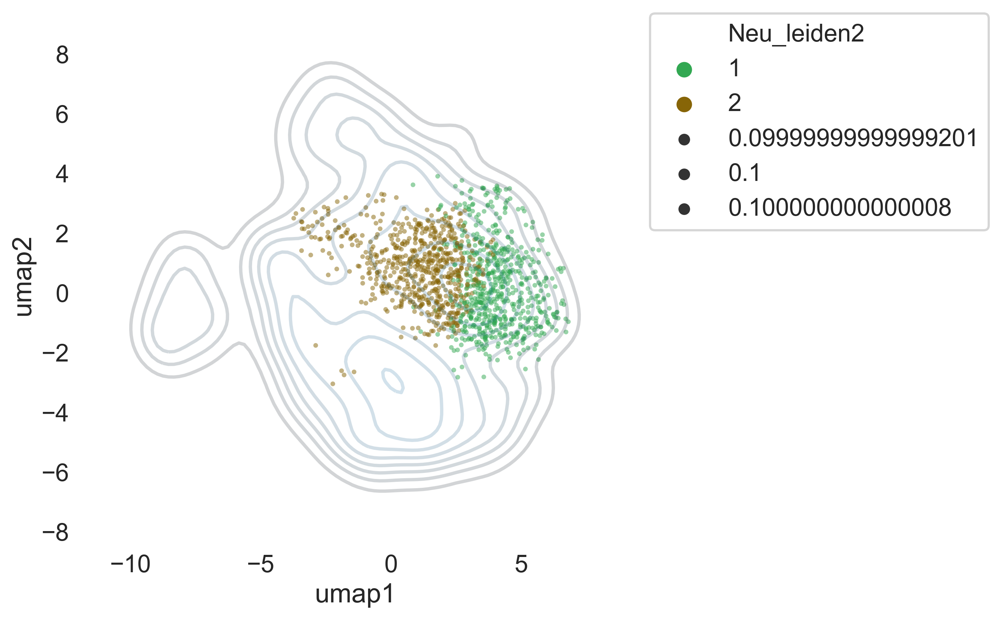

In [46]:
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.kdeplot(data = neu_clean_df['umap1'], data2= neu_clean_df['umap2'], shade = False, 
            shade_lowest=False, ax = ax, alpha = 0.2, cbar = False)
sns.scatterplot(data = EV[EV['Neu_leiden2'].isin(['1', '2'])], hue = 'Neu_leiden2', palette = Neu_leiden2_dict, x='umap1', y='umap2', marker='.', size = 0.1, linewidth = 0, alpha = 0.5, ax = ax)
sns.despine(f, left=True, bottom=True)
sns.set_style("whitegrid", {'axes.grid' : False})
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

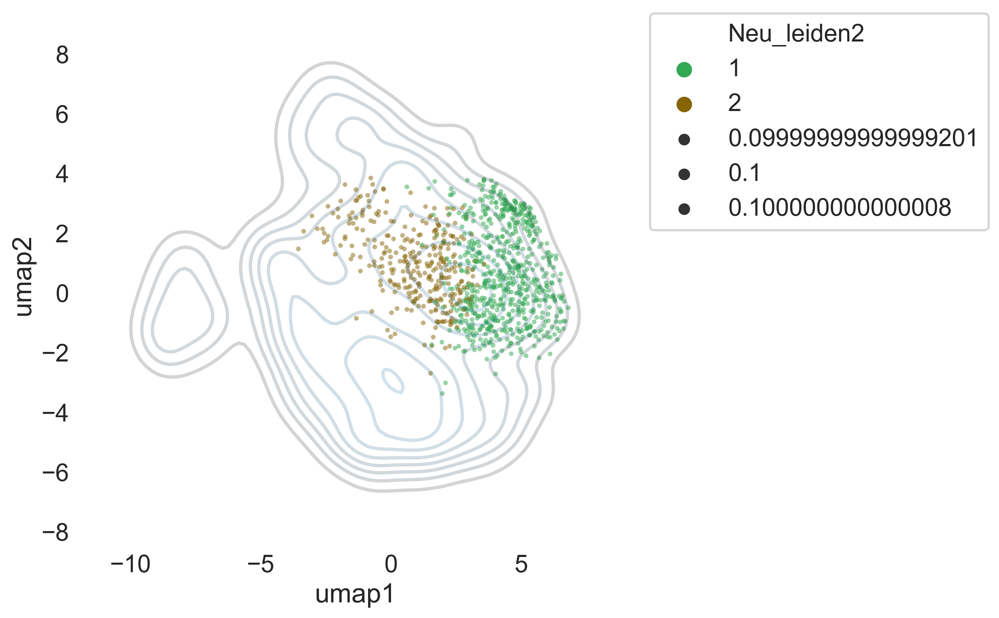

In [47]:
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.kdeplot(data = neu_clean_df['umap1'], data2= neu_clean_df['umap2'], shade = False, 
            shade_lowest=False, ax = ax, alpha = 0.2, cbar = False)
sns.scatterplot(data = PB[PB['Neu_leiden2'].isin(['1', '2'])], hue = 'Neu_leiden2', palette = Neu_leiden2_dict, x='umap1', y='umap2', marker='.', size = 0.1, linewidth = 0, alpha = 0.5, ax = ax)
sns.despine(f, left=True, bottom=True)
sns.set_style("whitegrid", {'axes.grid' : False})
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

# Supp Figure 4C

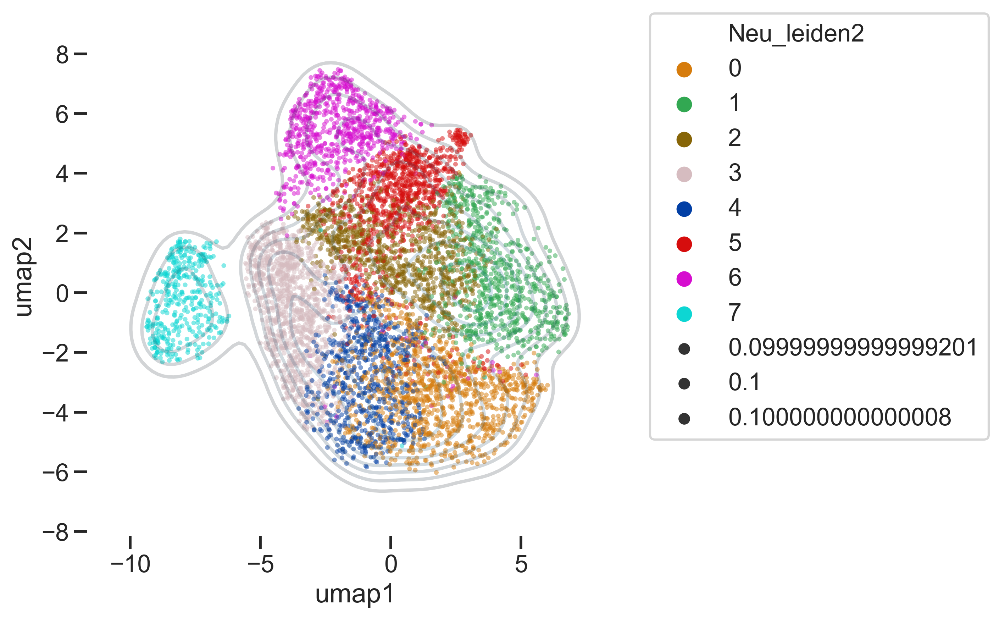

In [50]:
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.kdeplot(data =  neu_clean_df['umap1'], data2=  neu_clean_df['umap2'], shade = False, 
            shade_lowest=False, ax = ax, alpha = 0.2, cbar = False)
sns.scatterplot(data = TIS[TIS['Neu_leiden2'].isin(['0','1' ,'2', '3', '4', '5', '6', '7'])], hue = 'Neu_leiden2', palette = Neu_leiden2_dict, x='umap1', y='umap2', marker='.', size = 0.1, linewidth = 0, alpha = 0.5, ax = ax)
sns.despine(f, left=True, bottom=True)
sns.set_style("whitegrid", {'axes.grid' : False})
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

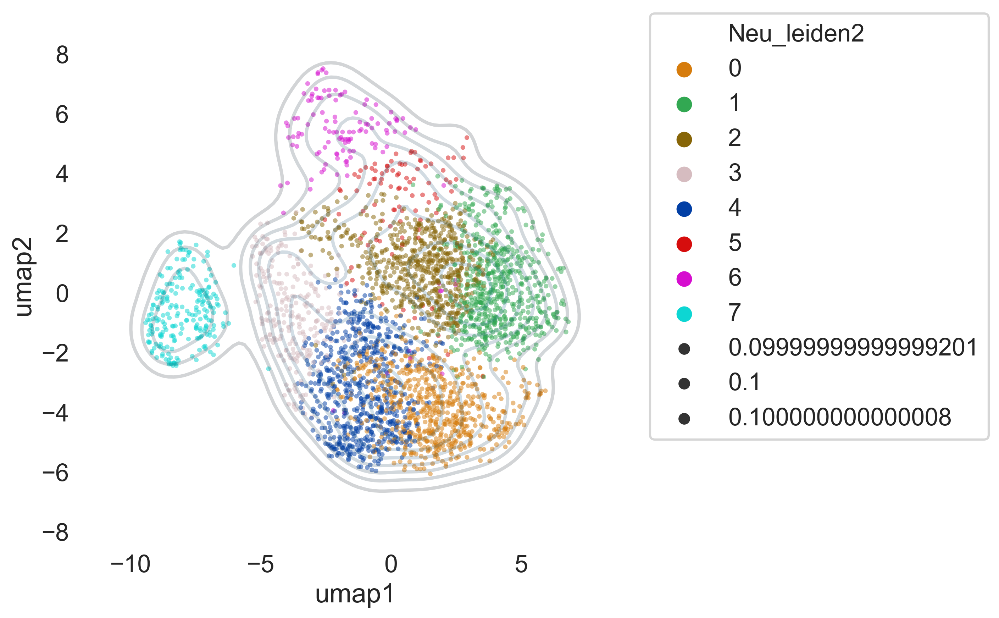

In [51]:
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.kdeplot(data =  neu_clean_df['umap1'], data2=  neu_clean_df['umap2'], shade = False, 
            shade_lowest=False, ax = ax, alpha = 0.2, cbar = False)
sns.scatterplot(data = EV[EV['Neu_leiden2'].isin(['0','1' ,'2', '3', '4', '5', '6', '7'])], hue = 'Neu_leiden2', palette = Neu_leiden2_dict, x='umap1', y='umap2', marker='.', size = 0.1, linewidth = 0, alpha = 0.5, ax = ax)
sns.despine(f, left=True, bottom=True)
sns.set_style("whitegrid", {'axes.grid' : False})
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

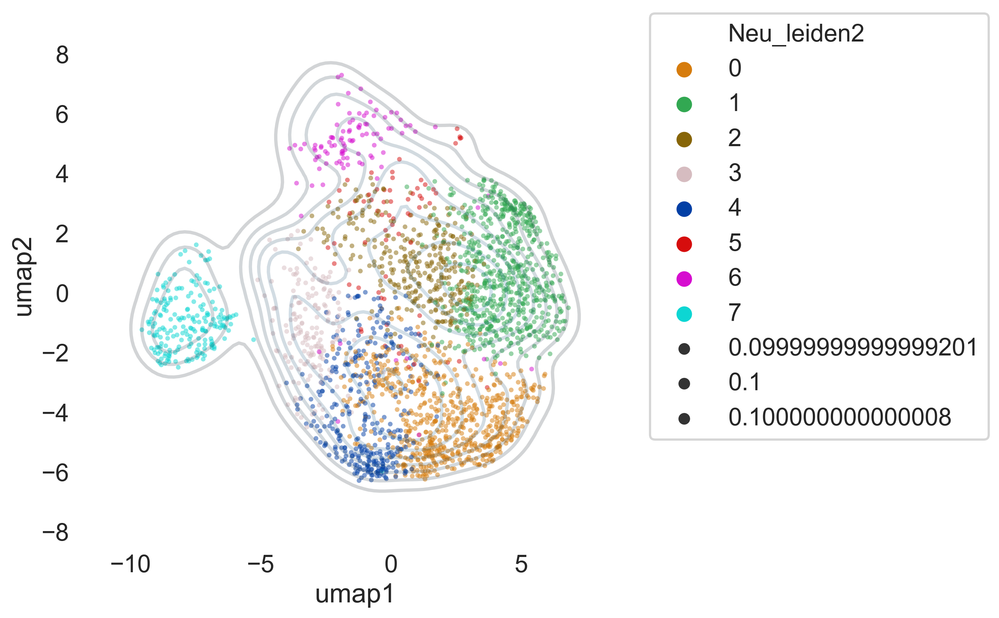

In [52]:
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.kdeplot(data =  neu_clean_df['umap1'], data2=  neu_clean_df['umap2'], shade = False, 
            shade_lowest=False, ax = ax, alpha = 0.2, cbar = False)
sns.scatterplot(data = PB[PB['Neu_leiden2'].isin(['0','1' ,'2', '3', '4', '5', '6', '7'])], hue = 'Neu_leiden2', palette = Neu_leiden2_dict, x='umap1', y='umap2', marker='.', size = 0.1, linewidth = 0, alpha = 0.5, ax = ax)
sns.despine(f, left=True, bottom=True)
sns.set_style("whitegrid", {'axes.grid' : False})
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

# Figure 4D

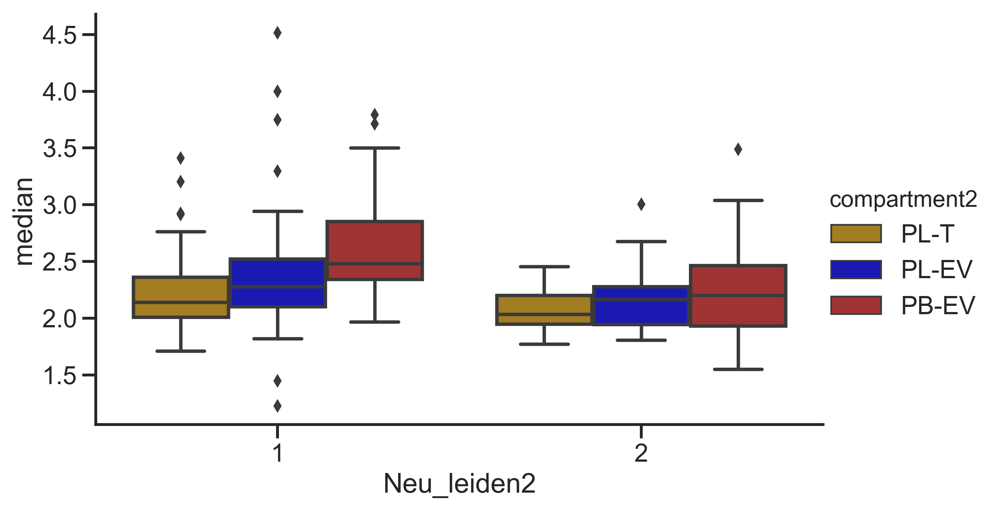

In [48]:
sns.set_style("ticks")
sns.catplot(x = 'Neu_leiden2', y = 'median', kind = 'box', hue_order = ['PL-T', 'PL-EV', 'PB-EV'],
            hue = 'compartment2', palette = {'PB-EV':'firebrick', 'PL-EV': 'mediumblue', 'PL-T': 'darkgoldenrod'},
            ci = 68, data = median_df[median_df['marker'].isin(['MHCII']) & median_df['Neu_leiden2'].isin(['1', '2'])],
            legend_out = True, aspect = 1.6, height = 5)

In [ ]:
from scipy.stats import ttest_ind

In [83]:
median_df.head(5)

,marker,Mo_leiden2,compartment2,challenge,cage,id,day,median
0,CD45-retroorbital,0,PB-EV,sal,428,14,E12.5,4.603326
1,CD45-retroorbital,0,PB-EV,sal,429,16,E18.5,4.903420
2,CD45-retroorbital,0,PB-EV,sal,429,20,E18.5,4.715041
3,CD45-retroorbital,0,PB-EV,sal,439,6,E14.5,0.041249
4,CD45-retroorbital,0,PB-EV,sal,748,5,E12.5,1.707534


In [84]:
pdl1_medians = median_df[median_df['marker'] == 'PD-L1']

In [85]:
t_test_pdl1 = pd.DataFrame(columns =['comp1', 'comp2', 'cluster','t-stat', 'p-value', 'Stat diff'])

In [86]:
combos = [('PL-T', 'PL-EV'), ('PL-T', 'PB-EV'),('PL-EV', 'PB-EV')]

In [87]:
for comb in combos:
    for cluster in ['0', '5','7']:
    
            comp1 = pdl1_medians[(pdl1_medians['Mo_leiden2']== cluster) & 
                                    (pdl1_medians['compartment2']== comb[0])]
            comp2 = pdl1_medians[(pdl1_medians['Mo_leiden2']== cluster) & 
                                    (pdl1_medians['compartment2']== comb[1])]

            t_stat, p = ttest_ind(comp1['median'], comp2['median'])
            alpha = 0.05
            if p > alpha:
                dist = 'no'
            else:
                dist = 'yes'
            data_df = pd.DataFrame(data ={'comp1': [comb[0]],
                                          'comp2': [comb[1]],
                                          'cluster': [cluster], 
                                          't-stat': [t_stat], 
                                          'p-value': [p], 
                                          'Stat diff':[ dist]})
            t_test_pdl1 = t_test_pdl1.append(data_df)

In [88]:
t_test_pdl1 

,comp1,comp2,cluster,t-stat,p-value,Stat diff
0,PL-T,PL-EV,0,6.287519,1.483718e-08,yes
0,PL-T,PL-EV,5,2.826176,5.947359e-03,yes
0,PL-T,PL-EV,7,-2.103178,3.885013e-02,yes
0,PL-T,PB-EV,0,9.925185,4.052746e-15,yes
0,PL-T,PB-EV,5,5.446111,5.512350e-07,yes
0,PL-T,PB-EV,7,1.266058,2.116026e-01,no
0,PL-EV,PB-EV,0,4.891791,6.730013e-06,yes
0,PL-EV,PB-EV,5,2.474621,1.556671e-02,yes
0,PL-EV,PB-EV,7,2.317030,2.665784e-02,yes


# Supp Figure 4D

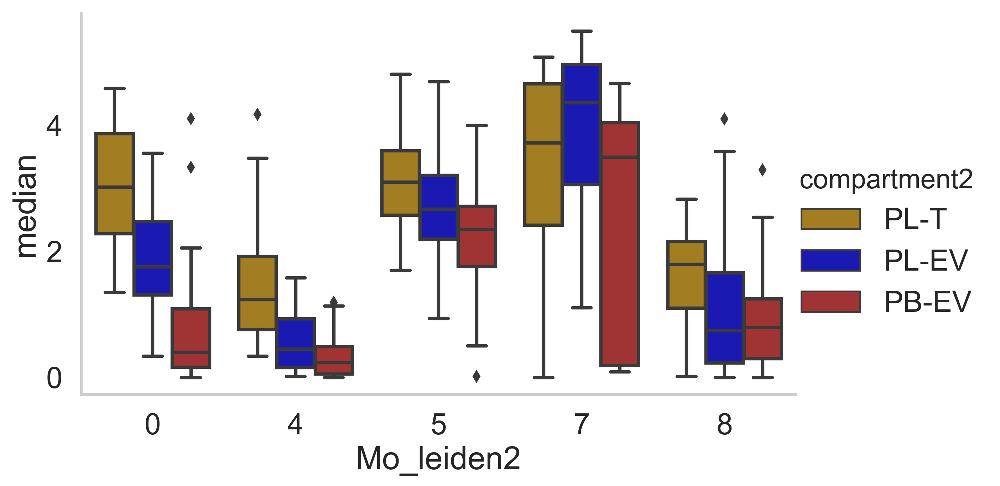

In [19]:
sns.catplot(x = 'Mo_leiden2', y = 'median', kind = 'box', hue_order = ['PL-T', 'PL-EV', 'PB-EV'],
            hue = 'compartment2', palette = {'PB-EV':'firebrick', 'PL-EV': 'mediumblue', 'PL-T': 'darkgoldenrod'},
            ci = 68, data = median_df[median_df['marker'].isin(['PD-L1']) & median_df['Mo_leiden2'].isin(['0', '4', '5', '7', '8'])],
            legend_out = True, aspect = 1.6, height = 5)

In [20]:
pdl1_medians = median_df[median_df['marker'] == 'PD-L1']
t_test_pdl1 = pd.DataFrame(columns =['comp1', 'comp2', 'cluster','t-stat', 'p-value', 'Stat diff'])
combos = [('PL-T', 'PL-EV'), ('PL-T', 'PB-EV'),('PL-EV', 'PB-EV')]
for comb in combos:
    for cluster in ['0', '4', '5','7', '8']:
    
            comp1 = pdl1_medians[(pdl1_medians['Mo_leiden2']== cluster) & 
                                    (pdl1_medians['compartment2']== comb[0])]
            comp2 = pdl1_medians[(pdl1_medians['Mo_leiden2']== cluster) & 
                                    (pdl1_medians['compartment2']== comb[1])]

            t_stat, p = ttest_ind(comp1['median'], comp2['median'])
            alpha = 0.05
            if p > alpha:
                dist = 'no'
            else:
                dist = 'yes'
            data_df = pd.DataFrame(data ={'comp1': [comb[0]],
                                          'comp2': [comb[1]],
                                          'cluster': [cluster], 
                                          't-stat': [t_stat], 
                                          'p-value': [p], 
                                          'Stat diff':[ dist]})
            t_test_pdl1 = t_test_pdl1.append(data_df)

In [21]:
t_test_pdl1

,comp1,comp2,cluster,t-stat,p-value,Stat diff
0,PL-T,PL-EV,0,6.287519,1.483718e-08,yes
0,PL-T,PL-EV,4,5.717353,1.746087e-07,yes
0,PL-T,PL-EV,5,2.826176,5.947359e-03,yes
0,PL-T,PL-EV,7,-2.103178,3.885013e-02,yes
0,PL-T,PL-EV,8,2.153158,3.456505e-02,yes
0,PL-T,PB-EV,0,9.925185,4.052746e-15,yes
0,PL-T,PB-EV,4,6.906520,1.248876e-09,yes
0,PL-T,PB-EV,5,5.446111,5.512350e-07,yes
0,PL-T,PB-EV,7,1.266058,2.116026e-01,no
0,PL-T,PB-EV,8,3.024502,3.582091e-03,yes


# Figure 4E

In [54]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
full_counts_csv = '20200521_maternal500wo_outliers_counts_per_sample_meta_clust.csv'
full_counts_filepath = os.path.join(subsample_path, full_counts_csv)
full_cell_counts = pd.read_csv(full_counts_filepath)  

In [61]:
full_cell_counts.head()

,cell_type_v2,compartment,organ,location,day,challenge,timePI,cage,id,test_status,counts,sample,sample_total,frac_of_comp_sample,compartment2
0,B cells,PB-EV,PB,EV,E10.5,sal,2hr,6942,8,test,194,6942_8_E10.5_sal_2hr_PB_EV,494,0.392713,PB-EV
1,B cells,PB-EV,PB,EV,E10.5,sal,2hr,6943,15,test,251,6943_15_E10.5_sal_2hr_PB_EV,484,0.518595,PB-EV
2,B cells,PB-EV,PB,EV,E10.5,sal,2hr,6944,16,test,142,6944_16_E10.5_sal_2hr_PB_EV,496,0.286290,PB-EV
3,B cells,PB-EV,PB,EV,E10.5,sal,2hr,6944,17,test,242,6944_17_E10.5_sal_2hr_PB_EV,485,0.498969,PB-EV
4,B cells,PB-EV,PB,EV,E10.5,sal,2hr,9582,15,test,135,9582_15_E10.5_sal_2hr_PB_EV,459,0.294118,PB-EV


In [56]:
samp_total_df = full_cell_counts.loc[:, ['sample', 'sample_total']]
samp_total_df.set_index('sample', inplace = True)
total_counts_dict = samp_total_df.to_dict()

In [57]:
cell_counts.loc[:,'full_sample_total'] = cell_counts.loc[:,'sample'].map(total_counts_dict['sample_total'])
cell_counts['frac_of_immune'] = cell_counts['counts']/cell_counts['full_sample_total']                                          
clean_counts_full = cell_counts[cell_counts['test_status'] == 'test']

In [65]:
cell_counts.head()

,Neu_leiden2,compartment2,organ,location,day,challenge,timePI,cage,id,test_status,counts,sample,sample_total,frac_of_comp_sample,full_sample_total,frac_of_immune
0,0,PB-EV,PB,EV,E10.5,sal,2hr,6942,8,test,16,6942_8_E10.5_sal_2hr_PB_EV,74,0.216216,494.0,0.032389
1,0,PB-EV,PB,EV,E10.5,sal,2hr,6943,15,test,13,6943_15_E10.5_sal_2hr_PB_EV,52,0.250000,484.0,0.026860
2,0,PB-EV,PB,EV,E10.5,sal,2hr,6944,16,test,16,6944_16_E10.5_sal_2hr_PB_EV,68,0.235294,496.0,0.032258
3,0,PB-EV,PB,EV,E10.5,sal,2hr,6944,17,test,6,6944_17_E10.5_sal_2hr_PB_EV,18,0.333333,485.0,0.012371
4,0,PB-EV,PB,EV,E10.5,sal,2hr,9582,15,test,16,9582_15_E10.5_sal_2hr_PB_EV,62,0.258065,459.0,0.034858


In [58]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
counts_csv = '20201019_maternalNeu_cell_type_counts_per_sample.csv'
counts_filepath = os.path.join(subsample_path, counts_csv)
clean_counts_full.to_csv(counts_filepath, index = False)  

In [59]:
clean_counts_full.head(5)

,Neu_leiden2,compartment2,organ,location,day,challenge,timePI,cage,id,test_status,counts,sample,sample_total,frac_of_comp_sample,full_sample_total,frac_of_immune
0,0,PB-EV,PB,EV,E10.5,sal,2hr,6942,8,test,16,6942_8_E10.5_sal_2hr_PB_EV,74,0.216216,494.0,0.032389
1,0,PB-EV,PB,EV,E10.5,sal,2hr,6943,15,test,13,6943_15_E10.5_sal_2hr_PB_EV,52,0.250000,484.0,0.026860
2,0,PB-EV,PB,EV,E10.5,sal,2hr,6944,16,test,16,6944_16_E10.5_sal_2hr_PB_EV,68,0.235294,496.0,0.032258
3,0,PB-EV,PB,EV,E10.5,sal,2hr,6944,17,test,6,6944_17_E10.5_sal_2hr_PB_EV,18,0.333333,485.0,0.012371
4,0,PB-EV,PB,EV,E10.5,sal,2hr,9582,15,test,16,9582_15_E10.5_sal_2hr_PB_EV,62,0.258065,459.0,0.034858


In [67]:
neu_clust = clean_counts_full[~(clean_counts_full['timePI'] == '24hr')]

In [68]:
neu_clust['Neu_leiden2']= neu_clust['Neu_leiden2'].astype('str')

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [69]:
neu_clust.head()

,Neu_leiden2,compartment2,organ,location,day,challenge,timePI,cage,id,test_status,counts,sample,sample_total,frac_of_comp_sample,full_sample_total,frac_of_immune
0,0,PB-EV,PB,EV,E10.5,sal,2hr,6942,8,test,16,6942_8_E10.5_sal_2hr_PB_EV,74,0.216216,494.0,0.032389
1,0,PB-EV,PB,EV,E10.5,sal,2hr,6943,15,test,13,6943_15_E10.5_sal_2hr_PB_EV,52,0.250000,484.0,0.026860
2,0,PB-EV,PB,EV,E10.5,sal,2hr,6944,16,test,16,6944_16_E10.5_sal_2hr_PB_EV,68,0.235294,496.0,0.032258
3,0,PB-EV,PB,EV,E10.5,sal,2hr,6944,17,test,6,6944_17_E10.5_sal_2hr_PB_EV,18,0.333333,485.0,0.012371
4,0,PB-EV,PB,EV,E10.5,sal,2hr,9582,15,test,16,9582_15_E10.5_sal_2hr_PB_EV,62,0.258065,459.0,0.034858


In [70]:
int_days = ['E10.5', 'E14.5', 'E18.5']

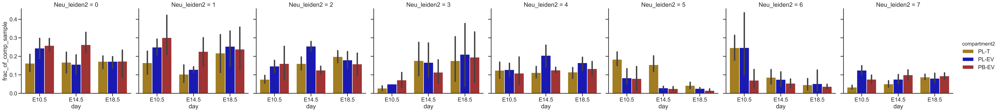

In [71]:
sns.set_style("ticks")
g = sns.catplot(x='day', y='frac_of_comp_sample',
                col='Neu_leiden2', data= neu_clust[neu_clust['day'].isin(int_days)], 
                kind='bar', hue = 'compartment2',hue_order = ['PL-T', 'PL-EV', 'PB-EV'],
                palette= {'PL-EV': 'mediumblue', 'PL-T': 'darkgoldenrod', 'PB-EV':'firebrick',}, sharey = True,
                height=5, aspect=1)

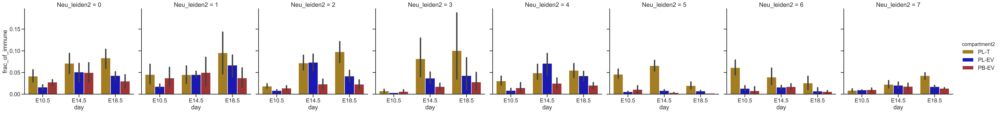

In [72]:
sns.set_style("ticks")
g = sns.catplot(x='day', y='frac_of_immune',
                col='Neu_leiden2', data= neu_clust[neu_clust['day'].isin(int_days)], 
                kind='bar', hue = 'compartment2',hue_order = ['PL-T', 'PL-EV', 'PB-EV'],
                palette= {'PL-EV': 'mediumblue', 'PL-T': 'darkgoldenrod', 'PB-EV':'firebrick',}, sharey = True,
                height=5, aspect=1)

In [84]:
days = [('E10.5', 'E14.5'), ('E14.5', 'E18.5'), ('E18.5', 'E10.5')]
combos = [('PL-T', 'PL-EV'), ('PL-EV', 'PB-EV'), ('PB-EV', 'PL-T')]
t_test_immune_frac = pd.DataFrame(columns =['cluster', 'comp_only','day1', 'day2', 't-stat_day', 'p-value_day', 'Stat diff day', 'comp1', 'comp2', 'day_only', 't-stat_comp', 'p-value_comp', 'Stat diff comp'])

for cluster in ['0', '5','7']:   
    for comb in combos:
        for day in days: 
                day1 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[0])&
                                        (pdl1_clust['day']== day[0])]
                day2 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[0])&
                                        (pdl1_clust['day']== day[1])]

                t_stat_day, p_day = ttest_ind(day1['frac_of_immune'], day2['frac_of_immune'])
                alpha = 0.05
                if p_day > alpha:
                    dist_day = 'no'
                else:
                    dist_day = 'yes'

                comp_1 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[0])&
                                        (pdl1_clust['day']== day[0])]
                comp_2 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[1])&
                                        (pdl1_clust['day']== day[0])]

                t_stat_comp, p_comp = ttest_ind(comp_1['frac_of_pdl1_pos'], comp_2['frac_of_pdl1_pos'])
                alpha = 0.05
                if p_comp > alpha:
                    dist_comp = 'no'
                else:
                    dist_comp = 'yes'


                data_df = pd.DataFrame(data ={'cluster': [cluster],
                                              'comp_only': [comb[0]],
                                              'day1':[day[0]],
                                              'day2':[day[1]],
                                              't-stat_day': [t_stat_day], 
                                              'p-value_day': [p_day], 
                                              'Stat diff day':[ dist_day],
                                              'comp1': [comb[0]],
                                              'comp2': [comb[1]],
                                              'day_only':[day[0]],
                                              't-stat_comp': [t_stat_comp], 
                                              'p-value_comp': [p_comp], 
                                              'Stat diff comp':[ dist_comp]})
                t_test_immune_frac = t_test_immune_frac.append(data_df)

In [85]:
day1 = pdl1_clust[(pdl1_clust['Mo_leiden2']== '0') & 
                                        (pdl1_clust['compartment2']== 'PL-T')&
                                        (pdl1_clust['day']== 'E10.5')]

In [86]:
pdl1_clust[(pdl1_clust['Mo_leiden2']== '0') & 
                                        (pdl1_clust['compartment2']== 'PL-T')&
                                        (pdl1_clust['day']== 'E14.5')]

,Mo_leiden2,compartment2,organ,location,day,challenge,timePI,cage,id,test_status,counts,sample,sample_total,frac_of_comp_sample,full_sample_total,frac_of_immune,PDL1_status,pdl1_counts,frac_of_pdl1_pos
114,0,PL-T,PL_F,T,E14.5,sal,2hr,1136,1,test,23,1136_1_E14.5_sal_2hr_PL_F_T,125,0.184000,321.0,0.071651,pos,31.0,0.741935
115,0,PL-T,PL_F,T,E14.5,sal,2hr,8240,11,test,21,8240_11_E14.5_sal_2hr_PL_F_T,133,0.157895,354.0,0.059322,pos,30.0,0.700000
116,0,PL-T,PL_F,T,E14.5,sal,2hr,9581,10,test,6,9581_10_E14.5_sal_2hr_PL_F_T,50,0.120000,177.0,0.033898,pos,18.0,0.333333
117,0,PL-T,PL_F,T,E14.5,sal,2hr,9581,10,test,2,9581_10_E14.5_sal_2hr_PL_F_T,50,0.040000,177.0,0.011299,pos,18.0,0.111111
118,0,PL-T,PL_F,T,E14.5,sal,2hr,9581,8,test,7,9581_8_E14.5_sal_2hr_PL_F_T,29,0.241379,132.0,0.053030,pos,17.0,0.411765
119,0,PL-T,PL_F,T,E14.5,sal,2hr,9581,9,test,33,9581_9_E14.5_sal_2hr_PL_F_T,96,0.343750,209.0,0.157895,pos,51.0,0.647059
154,0,PL-T,PL_M,T,E14.5,sal,2hr,8240,11,test,32,8240_11_E14.5_sal_2hr_PL_M_T,103,0.310680,311.0,0.102894,pos,49.0,0.653061
155,0,PL-T,PL_M,T,E14.5,sal,2hr,9581,10,test,8,9581_10_E14.5_sal_2hr_PL_M_T,45,0.177778,174.0,0.045977,pos,19.0,0.421053
156,0,PL-T,PL_M,T,E14.5,sal,2hr,9581,8,test,14,9581_8_E14.5_sal_2hr_PL_M_T,54,0.259259,198.0,0.070707,pos,20.0,0.700000
157,0,PL-T,PL_M,T,E14.5,sal,2hr,9581,9,test,7,9581_9_E14.5_sal_2hr_PL_M_T,56,0.125000,163.0,0.042945,pos,22.0,0.318182


In [87]:
t_test_immune_frac

,cluster,comp_only,day1,day2,t-stat_day,p-value_day,Stat diff day,comp1,comp2,day_only,t-stat_comp,p-value_comp,Stat diff comp
0,0,PL-T,E10.5,E14.5,4.542092,4.605979e-04,yes,PL-T,PL-EV,E10.5,1.367552,0.201400,no
0,0,PL-T,E14.5,E18.5,1.830721,8.583120e-02,no,PL-T,PL-EV,E14.5,-0.249149,0.806067,no
0,0,PL-T,E18.5,E10.5,-10.016608,3.517673e-07,yes,PL-T,PL-EV,E18.5,-0.143266,0.888122,no
0,0,PL-EV,E10.5,E14.5,12.368634,6.336892e-09,yes,PL-EV,PB-EV,E10.5,2.559459,0.030714,yes
0,0,PL-EV,E14.5,E18.5,0.821600,4.233788e-01,no,PL-EV,PB-EV,E14.5,0.957117,0.359071,no
0,0,PL-EV,E18.5,E10.5,-9.345872,7.401038e-07,yes,PL-EV,PB-EV,E18.5,0.375300,0.716129,no
0,0,PB-EV,E10.5,E14.5,0.774439,4.680808e-01,no,PB-EV,PL-T,E10.5,-3.240483,0.010151,yes
0,0,PB-EV,E14.5,E18.5,1.195603,2.978840e-01,no,PB-EV,PL-T,E14.5,-0.812112,0.433951,no
0,0,PB-EV,E18.5,E10.5,-1.668952,1.461684e-01,no,PB-EV,PL-T,E18.5,-0.467435,0.651299,no
0,5,PL-T,E10.5,E14.5,1.516010,1.534499e-01,no,PL-T,PL-EV,E10.5,-2.581458,0.027348,yes


In [88]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
immune_cluststats_csv = '20200929_maternalmo_pdl1_ouof_immune_counts_stats.csv'
immune_cluststats_filepath = os.path.join(subsample_path, immune_cluststats_csv) 
t_test_immune_frac.to_csv(immune_cluststats_filepath, index = False)

# Supp Figure 3G

In [23]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
counts_csv = '20200928_maternalmo_nopdl1clust_cell_type_counts_per_sample.csv'
counts_filepath = os.path.join(subsample_path, counts_csv)
clean_counts_full= pd.read_csv(counts_filepath)

In [56]:
clean_counts_full['PDL1_status'] = np.where(clean_counts_full['Mo_leiden2'].isin(['0', '4', '5', '7', '8']), 'pos', 'neg')
PDL1_counts_df = clean_counts_full.groupby(['PDL1_status', 'sample']).sum()
pdl1_dict = PDL1_counts_df.loc['pos', 'counts'].to_dict()
clean_counts_full.loc[:,'pdl1_counts'] = clean_counts_full.loc[:,'sample'].map(pdl1_dict)
pdl1_clust = clean_counts_full[clean_counts_full['Mo_leiden2'].isin(['0', '4', '5', '7', '8'])]
pdl1_clust['frac_of_pdl1_pos'] = pdl1_clust['counts']/clean_counts_full['pdl1_counts'] 

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


In [59]:
pdl1_clust['Mo_leiden2']= pdl1_clust['Mo_leiden2'].astype('str')

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [28]:
int_days = ['E10.5', 'E14.5', 'E18.5']

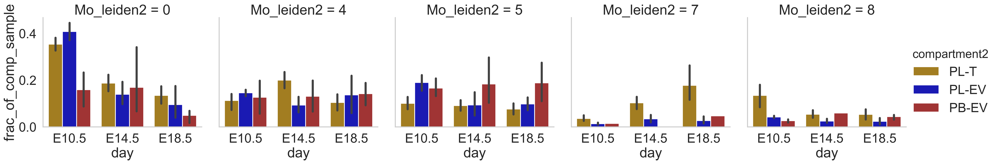

In [29]:
sns.set_context('talk', font_scale= 1.5)
g = sns.catplot(x='day', y='frac_of_comp_sample',
                col='Mo_leiden2', data= pdl1_clust[pdl1_clust['day'].isin(int_days)], 
                kind='bar', hue = 'compartment2',hue_order = ['PL-T', 'PL-EV', 'PB-EV'],
                palette= {'PL-EV': 'mediumblue', 'PL-T': 'darkgoldenrod', 'PB-EV':'firebrick',}, sharey = True,
                height=5, aspect=1)

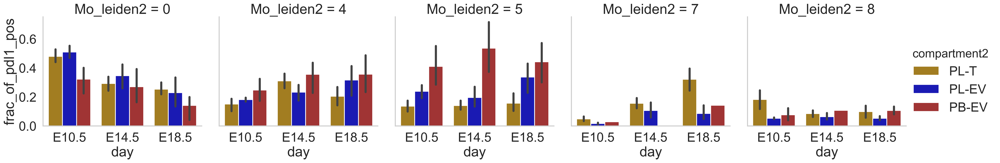

In [30]:
sns.set_context('talk', font_scale= 1.5)
g = sns.catplot(x='day', y='frac_of_pdl1_pos',
                col='Mo_leiden2', data=  pdl1_clust[pdl1_clust['day'].isin(int_days)], 
                kind='bar', hue = 'compartment2',hue_order = ['PL-T', 'PL-EV', 'PB-EV'],
                palette= {'PL-EV': 'mediumblue', 'PL-T': 'darkgoldenrod', 'PB-EV':'firebrick',}, sharey = True,
                height=5, aspect=1)

In [60]:
days = [('E10.5', 'E14.5'), ('E14.5', 'E18.5'), ('E18.5', 'E10.5')]
combos = [('PL-T', 'PL-EV'), ('PL-EV', 'PB-EV'), ('PB-EV', 'PL-T')]
t_test_pdl1_frac = pd.DataFrame(columns =['cluster', 'comp_only','day1', 'day2', 't-stat_day', 'p-value_day', 'Stat diff day', 'comp1', 'comp2', 'day_only', 't-stat_comp', 'p-value_comp', 'Stat diff comp'])

for cluster in ['0', '4','5','7', '8']:   
    for comb in combos:
        for day in days: 
                day1 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[0])&
                                        (pdl1_clust['day']== day[0])]
                day2 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[0])&
                                        (pdl1_clust['day']== day[1])]

                t_stat_day, p_day = ttest_ind(day1['frac_of_pdl1_pos'], day2['frac_of_pdl1_pos'])
                alpha = 0.05
                if p_day > alpha:
                    dist_day = 'no'
                else:
                    dist_day = 'yes'

                comp_1 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[0])&
                                        (pdl1_clust['day']== day[0])]
                comp_2 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[1])&
                                        (pdl1_clust['day']== day[0])]

                t_stat_comp, p_comp = ttest_ind(comp_1['frac_of_pdl1_pos'], comp_2['frac_of_pdl1_pos'])
                alpha = 0.05
                if p_comp > alpha:
                    dist_comp = 'no'
                else:
                    dist_comp = 'yes'


                data_df = pd.DataFrame(data ={'cluster': [cluster],
                                              'comp_only': [comb[0]],
                                              'day1':[day[0]],
                                              'day2':[day[1]],
                                              't-stat_day': [t_stat_day], 
                                              'p-value_day': [p_day], 
                                              'Stat diff day':[ dist_day],
                                              'comp1': [comb[0]],
                                              'comp2': [comb[1]],
                                              'day_only':[day[0]],
                                              't-stat_comp': [t_stat_comp], 
                                              'p-value_comp': [p_comp], 
                                              'Stat diff comp':[ dist_comp]})
                t_test_pdl1_frac = t_test_pdl1_frac.append(data_df)

In [61]:
t_test_pdl1_frac

,cluster,comp_only,day1,day2,t-stat_day,p-value_day,Stat diff day,comp1,comp2,day_only,t-stat_comp,p-value_comp,Stat diff comp
0,0,PL-T,E10.5,E14.5,4.103838,0.000507,yes,PL-T,PL-EV,E10.5,-0.875358,0.401915,no
0,0,PL-T,E14.5,E18.5,0.969763,0.342253,no,PL-T,PL-EV,E14.5,-1.113328,0.275755,no
0,0,PL-T,E18.5,E10.5,-6.510501,0.000029,yes,PL-T,PL-EV,E18.5,0.395305,0.698576,no
0,0,PL-EV,E10.5,E14.5,2.467790,0.026112,yes,PL-EV,PB-EV,E10.5,3.392448,0.007968,yes
0,0,PL-EV,E14.5,E18.5,1.621616,0.123284,no,PL-EV,PB-EV,E14.5,0.926070,0.370099,no
0,0,PL-EV,E18.5,E10.5,-4.106602,0.001455,yes,PL-EV,PB-EV,E18.5,0.891265,0.395989,no
0,0,PB-EV,E10.5,E14.5,0.603996,0.562578,no,PB-EV,PL-T,E10.5,-2.803567,0.020592,yes
0,0,PB-EV,E14.5,E18.5,1.338437,0.229239,no,PB-EV,PL-T,E14.5,-0.378149,0.709304,no
0,0,PB-EV,E18.5,E10.5,-2.236397,0.066677,no,PB-EV,PL-T,E18.5,-2.312069,0.046080,yes
0,4,PL-T,E10.5,E14.5,-3.477520,0.002376,yes,PL-T,PL-EV,E10.5,-1.193982,0.260039,no


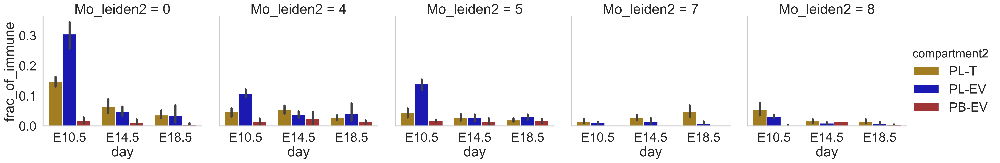

In [34]:
sns.set_context('talk', font_scale= 1.5)
g = sns.catplot(x='day', y='frac_of_immune',
                col='Mo_leiden2', data= pdl1_clust[pdl1_clust['day'].isin(int_days)], 
                kind='bar', hue = 'compartment2',hue_order = ['PL-T', 'PL-EV', 'PB-EV'],
                palette= {'PL-EV': 'mediumblue', 'PL-T': 'darkgoldenrod', 'PB-EV':'firebrick',}, sharey = True,
                height=5, aspect=1)

In [62]:
days = [('E10.5', 'E14.5'), ('E14.5', 'E18.5'), ('E18.5', 'E10.5')]
combos = [('PL-T', 'PL-EV'), ('PL-EV', 'PB-EV'), ('PB-EV', 'PL-T')]
t_test_immune_frac = pd.DataFrame(columns =['cluster', 'comp_only','day1', 'day2', 't-stat_day', 'p-value_day', 'Stat diff day', 'comp1', 'comp2', 'day_only', 't-stat_comp', 'p-value_comp', 'Stat diff comp'])

for cluster in ['0', '4', '5','7', '8']:   
    for comb in combos:
        for day in days: 
                day1 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[0])&
                                        (pdl1_clust['day']== day[0])]
                day2 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[0])&
                                        (pdl1_clust['day']== day[1])]

                t_stat_day, p_day = ttest_ind(day1['frac_of_immune'], day2['frac_of_immune'])
                alpha = 0.05
                if p_day > alpha:
                    dist_day = 'no'
                else:
                    dist_day = 'yes'

                comp_1 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[0])&
                                        (pdl1_clust['day']== day[0])]
                comp_2 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[1])&
                                        (pdl1_clust['day']== day[0])]

                t_stat_comp, p_comp = ttest_ind(comp_1['frac_of_pdl1_pos'], comp_2['frac_of_pdl1_pos'])
                alpha = 0.05
                if p_comp > alpha:
                    dist_comp = 'no'
                else:
                    dist_comp = 'yes'


                data_df = pd.DataFrame(data ={'cluster': [cluster],
                                              'comp_only': [comb[0]],
                                              'day1':[day[0]],
                                              'day2':[day[1]],
                                              't-stat_day': [t_stat_day], 
                                              'p-value_day': [p_day], 
                                              'Stat diff day':[ dist_day],
                                              'comp1': [comb[0]],
                                              'comp2': [comb[1]],
                                              'day_only':[day[0]],
                                              't-stat_comp': [t_stat_comp], 
                                              'p-value_comp': [p_comp], 
                                              'Stat diff comp':[ dist_comp]})
                t_test_immune_frac = t_test_immune_frac.append(data_df)

In [63]:
t_test_immune_frac

,cluster,comp_only,day1,day2,t-stat_day,p-value_day,Stat diff day,comp1,comp2,day_only,t-stat_comp,p-value_comp,Stat diff comp
0,0,PL-T,E10.5,E14.5,NaN,NaN,yes,PL-T,PL-EV,E10.5,-0.875358,0.401915,no
0,0,PL-T,E14.5,E18.5,NaN,NaN,yes,PL-T,PL-EV,E14.5,-1.113328,0.275755,no
0,0,PL-T,E18.5,E10.5,-10.016608,3.517673e-07,yes,PL-T,PL-EV,E18.5,0.395305,0.698576,no
0,0,PL-EV,E10.5,E14.5,NaN,NaN,yes,PL-EV,PB-EV,E10.5,3.392448,0.007968,yes
0,0,PL-EV,E14.5,E18.5,NaN,NaN,yes,PL-EV,PB-EV,E14.5,0.926070,0.370099,no
0,0,PL-EV,E18.5,E10.5,-9.345872,7.401038e-07,yes,PL-EV,PB-EV,E18.5,0.891265,0.395989,no
0,0,PB-EV,E10.5,E14.5,NaN,NaN,yes,PB-EV,PL-T,E10.5,-2.803567,0.020592,yes
0,0,PB-EV,E14.5,E18.5,NaN,NaN,yes,PB-EV,PL-T,E14.5,-0.378149,0.709304,no
0,0,PB-EV,E18.5,E10.5,-1.668952,1.461684e-01,no,PB-EV,PL-T,E18.5,-2.312069,0.046080,yes
0,4,PL-T,E10.5,E14.5,NaN,NaN,yes,PL-T,PL-EV,E10.5,-1.193982,0.260039,no
